In [1]:
import os
import glob
import os
import pandas as pd
import numpy as np
import yaml
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse as sp
from tqdm import tqdm
import time
from scipy.spatial.distance import cdist
import scipy
from scanpy.tools._utils import get_init_pos_from_paga 

import rmm
import cupy
import cudf
import cupy as cp
# import cvxpy as cpv
from cuml.metrics import pairwise_distances
from cuml.metrics import nan_euclidean_distances
from rmm.allocators.cupy import rmm_cupy_allocator
import anndata as an
import scanpy as sc
import rapids_singlecell as rsc
import scvi
import matplotlib.ticker as ticker
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap

# Enable `managed_memory`
rmm.reinitialize(
    managed_memory=True,
    pool_allocator=False,
)
cp.cuda.set_allocator(rmm_cupy_allocator)

# Native cell types

In [2]:
%%time
fpath = "/nfs/turbo/umms-indikar/shared/projects/HSC/pipeline_outputs/hematokytos/processed/sample_1_adata.h5ad"

adata = sc.read_h5ad(fpath)
adata

CPU times: user 8.99 s, sys: 1min 4s, total: 1min 13s
Wall time: 3min 46s


/nfs/turbo/umms-indikar/Jillian/conda-envs/rapids/lib/python3.13/site-packages/anndata/_core/anndata.py:1791: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 1125041 × 52164
    obs: 'soma_joinid', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'observation_joinid', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_type', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars', 'basename', 'dataset_id_int', 'n_counts', 'n_genes', '_scvi_batch', '_scvi_labels', 'leiden'
    var: 'n_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'X_umap_X_scANVI', 'X_umap_raw_data', 'X_umap_scVI', '_scvi_manager_uuid', '_scvi_uuid', 'basename_colors', 'basename_palette

In [5]:
adata.obs[['soma_joinid', 'cell_type']].head()

,soma_joinid,cell_type
252022,18615957,fibroblast
257777,18675295,fibroblast
1231167,59490168,fibroblast of mammary gland
1269651,68707092,alveolar type 2 fibroblast cell
657717,45885083,fibroblast


In [3]:
adata.obs['leiden'].value_counts()

leiden
8     83740
9     67967
27    52238
1     49083
7     45042
      ...  
68     2378
52     2220
65     2111
59     1457
58     1330
Name: count, Length: 70, dtype: int64

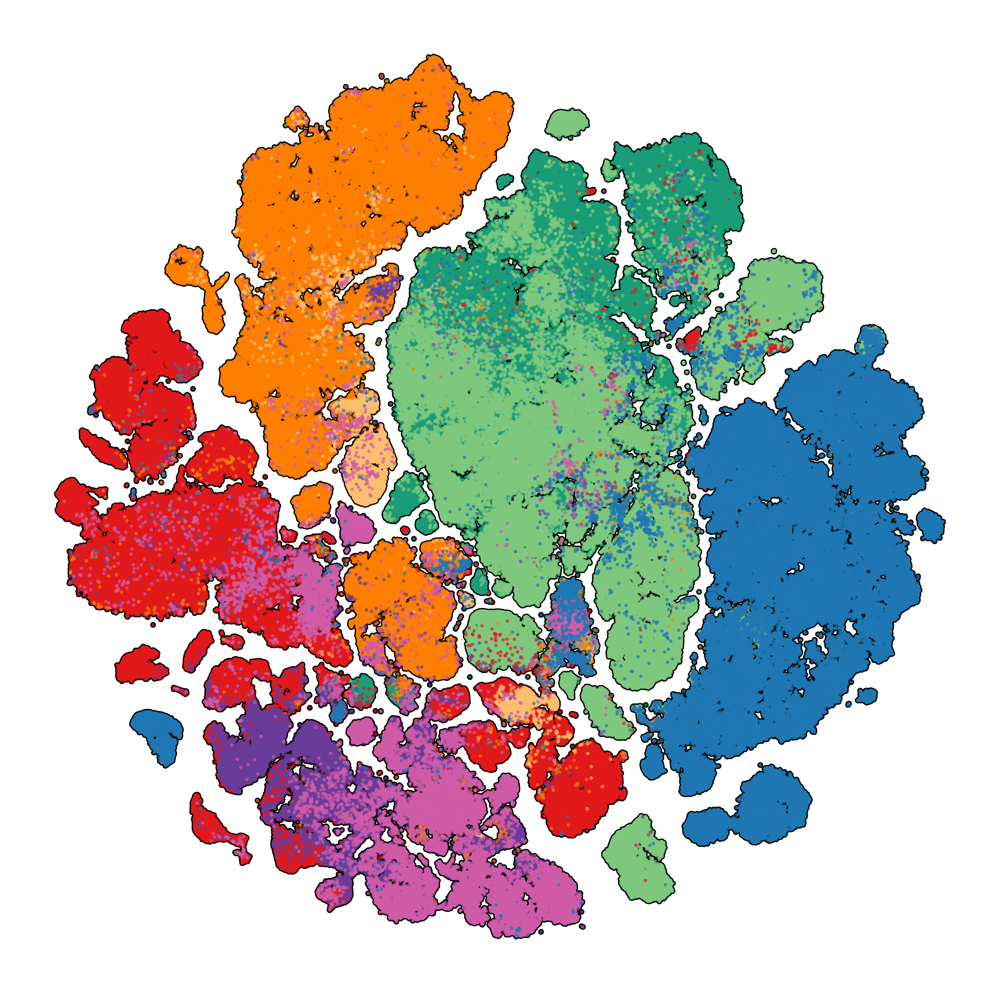

CPU times: user 20 s, sys: 151 ms, total: 20.1 s
Wall time: 20.3 s


In [3]:
%%time
palette = adata.uns['basename_palette']

plt.rcParams['figure.dpi'] = 200
plt.rcParams['figure.figsize'] = 10, 10

sc.pl.tsne(
    adata,
    color=['basename'],
    size=15,
    ncols=1,
    add_outline=True,
    outline_color=('k', 'k'),
    palette=palette,
    frameon=False,
    legend_loc='none',
    title="",
)

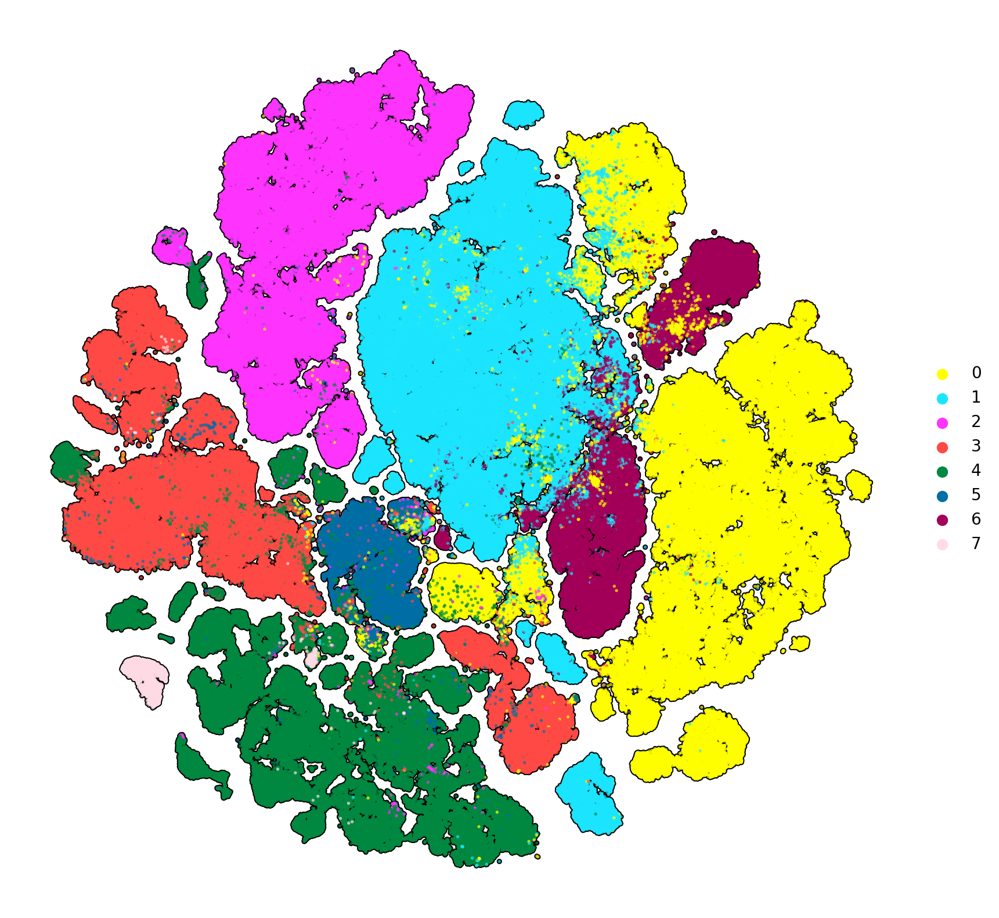

In [6]:
rsc.get.anndata_to_GPU(adata)

rsc.tl.leiden(
    adata,
    resolution=0.05,
)

plt.rcParams['figure.dpi'] = 200
plt.rcParams['figure.figsize'] = 10, 10

sc.pl.tsne(
    adata,
    color=['leiden'],
    size=15,
    ncols=1,
    add_outline=True,
    outline_color=('k', 'k'),
    # palette=palette,
    frameon=False,
    # legend_loc='none',
    title="",
)

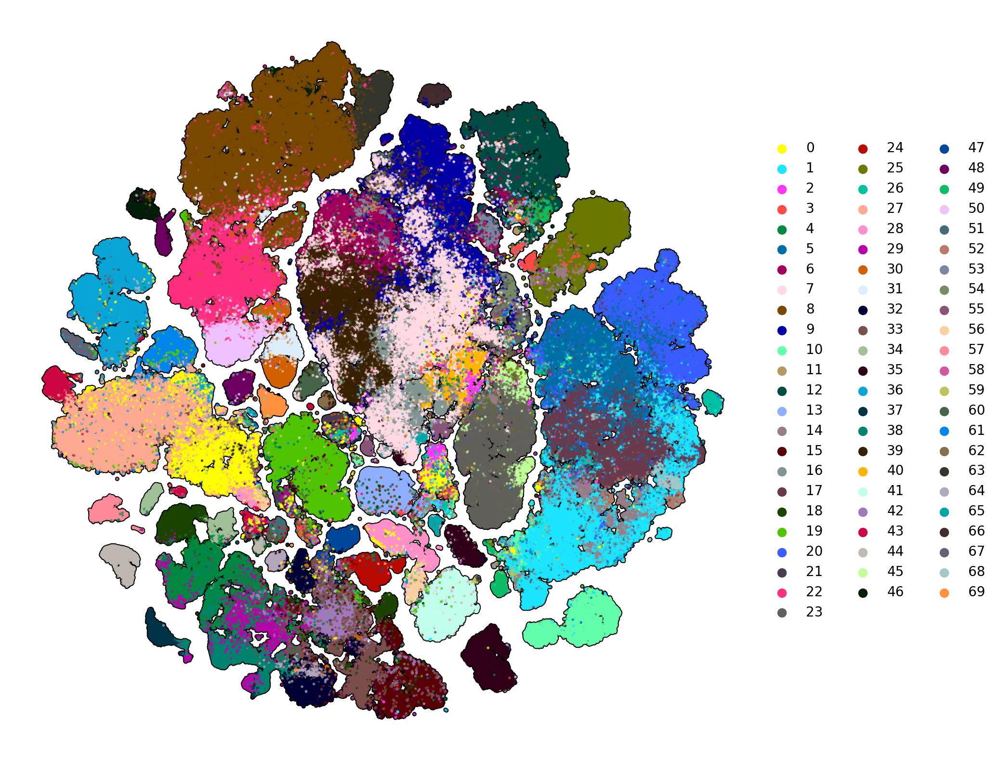

CPU times: user 24.2 s, sys: 131 ms, total: 24.3 s
Wall time: 24.5 s


In [4]:
%%time
plt.rcParams['figure.dpi'] = 200
plt.rcParams['figure.figsize'] = 10, 10

sc.pl.tsne(
    adata,
    color=['leiden'],
    size=15,
    ncols=1,
    add_outline=True,
    outline_color=('k', 'k'),
    # palette=palette,
    frameon=False,
    # legend_loc='none',
    title="",
)

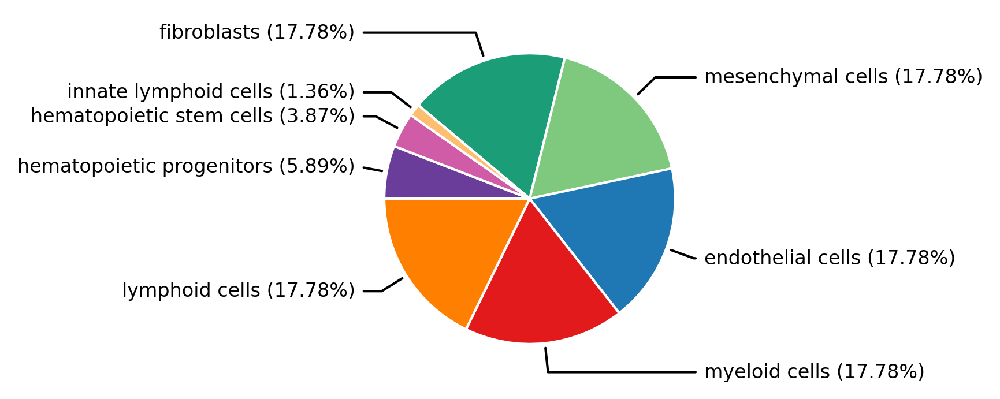

In [44]:
# Compute value counts
value_counts = adata.obs['basename'].value_counts()
total = value_counts.sum()

# Threshold for small categories
threshold = 0.01
small_mask = (value_counts / total) < threshold

# Group small categories into 'Other'
value_counts_grouped = value_counts[~small_mask].copy()
other_total = value_counts[small_mask].sum()

if other_total > 0:
    value_counts_grouped.loc['Other'] = other_total

# Get colors from the palette dict, use gray if 'Other' is included
colors = [
    palette.get(cat, '#CCCCCC')  # fallback color for 'Other' or missing keys
    for cat in value_counts_grouped.index
]


label_map = {
    'endothelial_cells': 'endothelial cells',
    'fibroblasts': 'fibroblasts',
    'mesenchymal_cells': 'mesenchymal cells',
    'hematopoietic_progenitors': 'hematopoietic progenitors',
    'hsc': 'hematopoietic stem cells',
    'innate_lymphoid_cells': 'innate lymphoid cells',
    'lymphoid_cells': 'lymphoid cells',
    'myeloid_cells': 'myeloid cells',
}

# Pie chart without labels
size = 5.75
fig, ax = plt.subplots(figsize=(size, size), dpi=300)
wedges, texts = ax.pie(
    value_counts_grouped,
    startangle=140,
    counterclock=False,
    wedgeprops=dict(linewidth=1, edgecolor='white'),
    colors=colors,
    labels=None
)

# Annotate each wedge with external labels + leader lines
for i, p in enumerate(wedges):
    ang = (p.theta2 - p.theta1)/2. + p.theta1
    x = np.cos(np.deg2rad(ang))
    y = np.sin(np.deg2rad(ang))
    
    horizontal_alignment = 'left' if x >= 0 else 'right'
    connectionstyle = f"angle,angleA=0,angleB={ang}"
    
    group_label = label_map.get(value_counts_grouped.index[i], value_counts_grouped.index[i])
    
    ax.annotate(
        # f"{value_counts_grouped.index[i].replace("_", " ")} ({value_counts_grouped.iloc[i] / total * 100:.2f}%)",
        f"{group_label} ({value_counts_grouped.iloc[i] / total * 100:.2f}%)",
        xy=(x, y),
        xytext=(1.2*np.sign(x), 1.2*y),
        horizontalalignment=horizontal_alignment,
        verticalalignment='center',
        arrowprops=dict(arrowstyle='-', connectionstyle=connectionstyle, color='k'),#'gray'),
        fontsize=8,
        bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.7)
    )

ax.set_ylabel('')
plt.tight_layout()
plt.show()

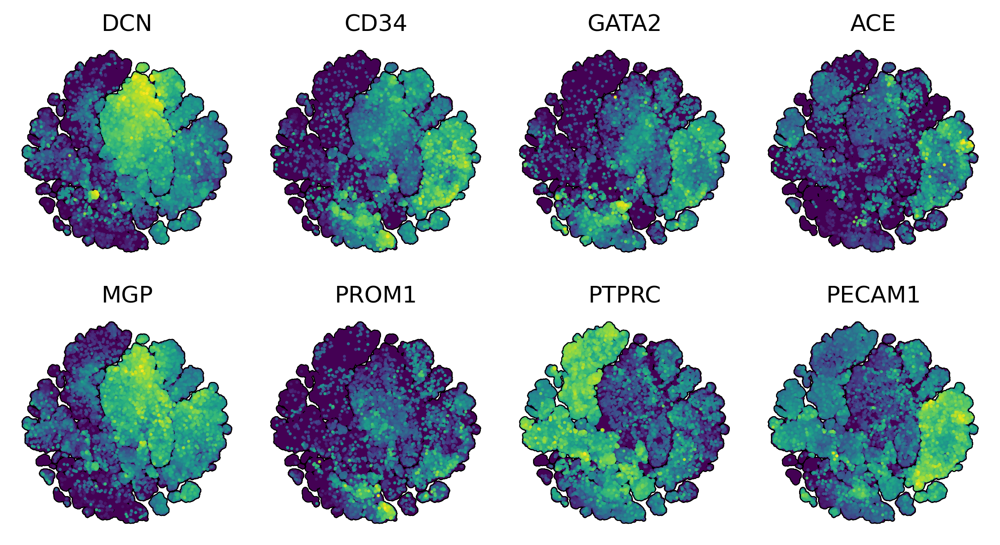

CPU times: user 3min 18s, sys: 5.71 s, total: 3min 24s
Wall time: 3min 26s


In [26]:
%%time

genes_to_plot = [
    # 'DCN', 'LUM', 'COL1A2', #fibroblast/mesenchymal
    # 'CD34', 'CD164', 'PTPRC', # HSC/immune
    # 'ACE', 'PECAM1', 'VWF', # endothelial
    
    # 'DCN', 'MGP', 'LUM',
    # 'CD34', 'GATA2', 'PTPRC',
    # 'ACE', 'VWF', 'PECAM1',
    
    'DCN', 'CD34', 'GATA2', 'ACE',
    'MGP', 'PROM1', 'PTPRC', 'PECAM1',
    
    #'CD34', #'ITGA6', 'THY1',
    # 'DCN', 'COL1A1', 'LUM',
    # 'ACE', 'PECAM1', 'VWF',
]

genes_to_plot = [g for g in genes_to_plot if g in adata.var_names]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 2, 2.15

sc.pl.tsne(
    adata,
    color=genes_to_plot,
    # sort_order=True,
    size=10,
    ncols=4,
    alpha=1,
    use_raw=False,
    add_outline=True,
    outline_color=('k', 'k'),
    frameon=False,
    colorbar_loc=None,
    wspace=0.1,
    # hspace=0.1,
    # layer='log_norm',
)

In [19]:
adata.obs[adata.obs['basename'] == 'mesenchymal_cells']['cell_type'].value_counts()

cell_type
mesenchymal cell                          66701
pericyte                                  55596
vascular associated smooth muscle cell    19992
mesothelial cell                          17141
adipocyte                                 14039
                                          ...  
small pre-B-II cell                           0
tonsil germinal center B cell                 0
transitional stage B cell                     0
unswitched memory B cell                      0
vein endothelial cell                         0
Name: count, Length: 188, dtype: int64

In [8]:
total_cells = adata.n_obs

# Randomly sample 100 unique indices
sampled_indices = np.random.choice(total_cells, size=1000, replace=False)

tdata = adata[sampled_indices, :].copy()
tdata

X = tdata.X.toarray() if hasattr(tdata.X, "toarray") else tdata.X
print(np.min(X), np.max(X), np.mean(X))

0.0 8.896336 0.045401685


/nfs/turbo/umms-indikar/Jillian/conda-envs/rapids/lib/python3.13/site-packages/anndata/_core/anndata.py:1791: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [3]:
adata.obs['basename'].value_counts()

basename
fibroblasts                  200000
mesenchymal_cells            200000
endothelial_cells            199989
myeloid_cells                199979
lymphoid_cells               199977
hematopoietic_progenitors     66279
hsc                           43540
innate_lymphoid_cells         15277
Name: count, dtype: int64

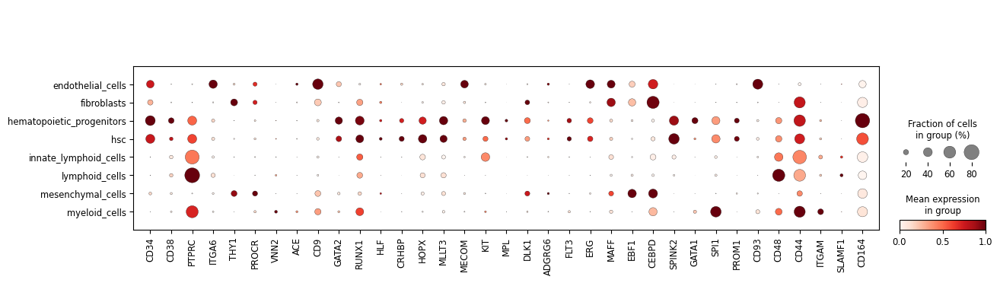

In [11]:
genes = [
    'CD34', 'CD38', 'PTPRC', 'ITGA6', 'THY1', 'PROCR', 'VNN2', 'ACE', 'CD9', 'GATA2', 'RUNX1', 'HLF', 'CRHBP', 
    'HOPX', 'MLLT3', 'MECOM', 'KIT', 'MPL', 'DLK1', 'ADGRG6', 'FLT3', 'CD273', 'HOX', 'ERG', 'MAFF', 'EBF1', 
    'CEBPD', 'SPINK2', 'GATA1', 'SPI1', 'PROM1', 'CD93', 'CD48', 'CD44', 'ITGAM', 'SLAMF1', 'CD164',
]

genes_to_plot = [g for g in genes if g in adata.var_names]

sc.pl.dotplot(
    adata,
    var_names=genes_to_plot,
    groupby='basename',
    dendrogram=False,
    standard_scale='var',
)

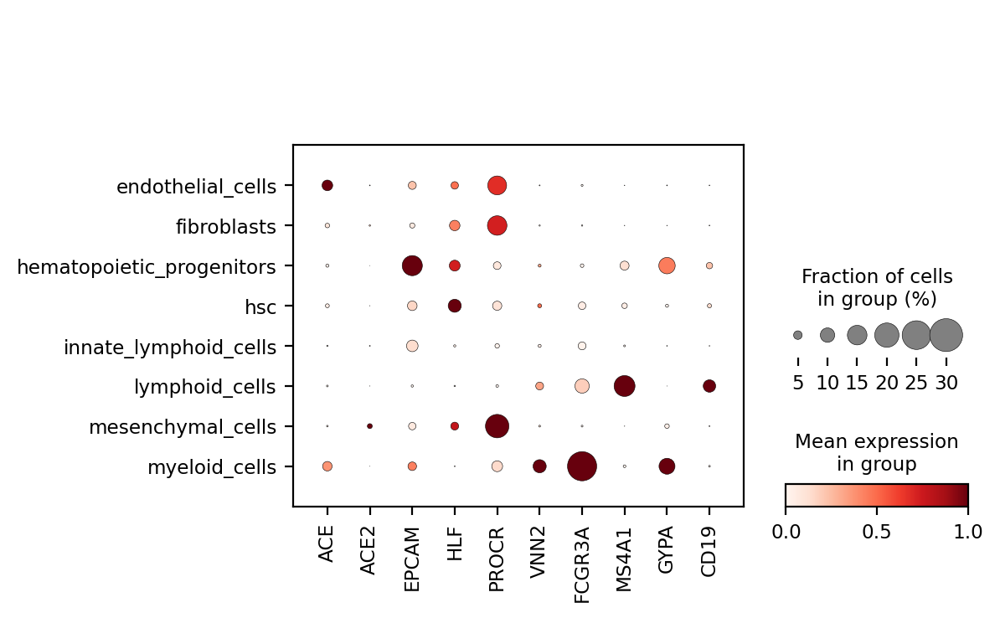

In [10]:
genes = [
    # # endothelial
    # 'MECOM', 'CD93', 'ITGA6', 'EMCN', 'PECAM1', 'ENG', 'VWF',
    # # fibroblasts
    # 'DCN', 'LUM', 'COL1A2', 'PRRX1', 'TWIST1',
    # # hematopoietic_progenitors
    # 'CD38', 'KIT', 'CD164',
    # # hsc
    # 'CD34', 'PROM1', 'GATA2', 'SPINK2', 'SERPINB1', 'LMO2', 'ENO1', 'HMGB1', 'SOX4', 'HMGA1', 'MYB',
    # # innate lymphoid
    # 'NCAM1', 'KLRB1', 'LST1', 'CD52',
    # # lymphoid
    # 'CD7', 'PTPRC', 'CD3E', 'CD3G',
    # # mesenchymal
    # 'THY1', 'ITGB1', 'FBLN5', 'HES4', 'ITGA7', 'CALD1', 'SPARC',
    # # myeloid
    # 'CD14', 'IL3RA', 'SPI1', 'ITGAM',
    
    'ACE', 'ACE2', 'EPCAM', 'HLF', 'PROCR', 'VNN2', 'FCGR3A', 'MS4A1', 'GYPA', 'CD19',
]


genes_to_plot = [g for g in genes if g in adata.var_names]

sc.pl.dotplot(
    adata,
    var_names=genes_to_plot,
    groupby='basename',
    dendrogram=False,
    standard_scale='var',
)

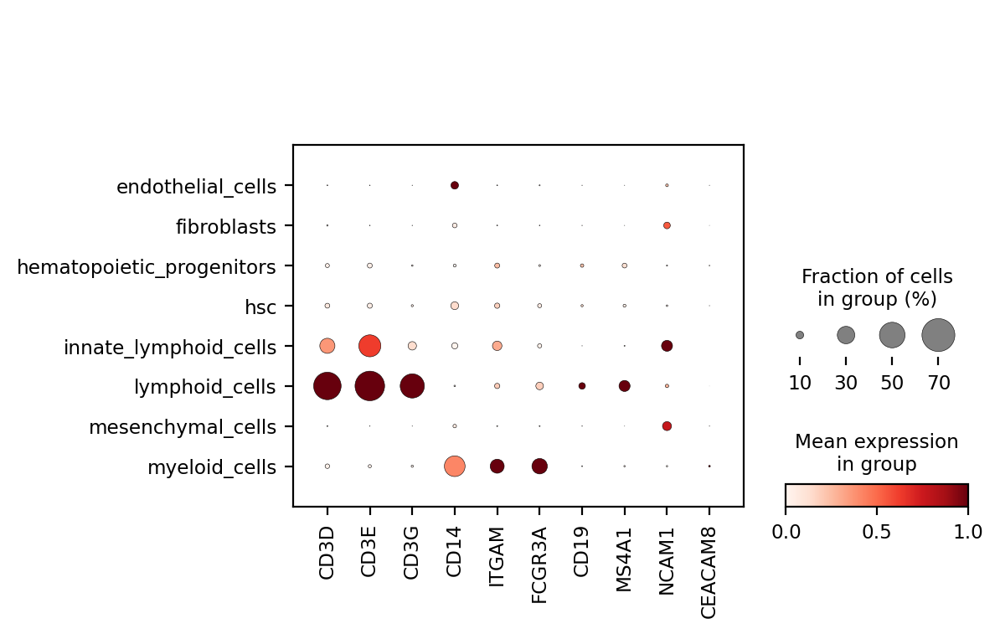

In [16]:
genes = [
    # Lin- markers
    'CD3D', 'CD3E', 'CD3G', # T cells
    'CD14', # Monocytes
    'ITGAM', # CD11b, myeloid cells
    'FCGR3A', # CD16, NK cells and granulocytes
    'CD19', 'MS4A1', # B cells (CD20)
    'NCAM1', # CD56, NK cells
    'GYPA' # GlyA, erythroid
    'PTPRC', # CD45R, B cells
    'CEACAM8', # CD66b, granulocytes
]


genes_to_plot = [g for g in genes if g in adata.var_names]

sc.pl.dotplot(
    adata,
    var_names=genes_to_plot,
    groupby='basename',
    dendrogram=False,
    standard_scale='var',
)

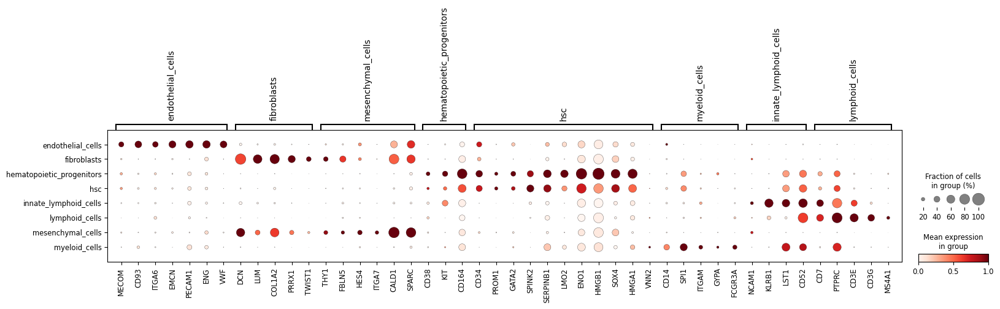

In [7]:
genes_by_group = {
    'endothelial_cells': ['MECOM', 'CD93', 'ITGA6', 'EMCN', 'PECAM1', 'ENG', 'VWF'],
    'fibroblasts': ['DCN', 'LUM', 'COL1A2', 'PRRX1', 'TWIST1'],
    'mesenchymal_cells': ['THY1', 'FBLN5', 'HES4', 'ITGA7', 'CALD1', 'SPARC'],
    'hematopoietic_progenitors': ['CD38', 'KIT', 'CD164'],
    'hsc': ['CD34', 'PROM1', 'GATA2', 'SPINK2', 'SERPINB1', 'LMO2', 'ENO1', 'HMGB1', 'SOX4', 'HMGA1', 'VNN2'],
    'myeloid_cells': ['SPI1', 'CD14', 'ITGAM', 'GYPA', 'FCGR3A'],
    'innate_lymphoid_cells': ['NCAM1', 'KLRB1', 'LST1', 'CD52'],
    'lymphoid_cells': ['CD7', 'PTPRC', 'CD3E', 'CD3G', 'MS4A1'],
}

sc.pl.dotplot(
    adata,
    genes_by_group,
    groupby='basename',
    dendrogram=False,
    standard_scale='var',
)

In [7]:
genes_by_group = {
    'endothelial_cells': ['MECOM', 'CD93', 'ITGA6', 'EMCN', 'PECAM1', 'ENG', 'VWF'],
    'fibroblasts': ['DCN', 'LUM', 'COL1A2', 'PRRX1', 'TWIST1'],
    'mesenchymal_cells': ['THY1', 'FBLN5', 'CALD1', 'SPARC', 'HES4', 'ITGA7'],
    'hematopoietic_progenitors': ['CD38', 'KIT', 'CD164'],
    'hsc': ['CD34', 'PROM1', 'GATA2', 'SPINK2', 'SERPINB1', 'LMO2', 'ENO1', 'HMGB1', 'SOX4', 'HMGA1', 'VNN2'],
    'myeloid_cells': ['SPI1', 'CD14', 'ITGAM', 'GYPA', 'FCGR3A'],
    'innate_lymphoid_cells': ['NCAM1', 'KLRB1', 'LST1', 'CD52'],
    'lymphoid_cells': ['CD7', 'PTPRC', 'CD3E', 'CD3G', 'MS4A1', 'CD19'],
}

genes = [g for grp in genes_by_group.values() for g in grp]
genes_to_plot = [g for g in genes if g in adata.var_names]
genes_to_plot.reverse()

groups = [grp for grp in genes_by_group.keys()]

avg_expr = pd.DataFrame(index=genes_to_plot, columns=groups)
pct_expr = pd.DataFrame(index=genes_to_plot, columns=groups)

for g in groups:
    cells = adata.obs['basename'] == g
    data = adata[cells, genes_to_plot].X
    # If sparse matrix
    if not isinstance(data, np.ndarray):
        data = data.toarray()
    avg_expr[g] = data.mean(axis=0)
    pct_expr[g] = (data > 0).mean(axis=0) * 100

# Z-score by gene
avg_expr = avg_expr.T   
avg_expr_z = avg_expr.apply(scipy.stats.zscore, axis=0)
avg_expr_z = avg_expr_z.T

print(avg_expr_z.shape)
avg_expr_z.head()

(47, 8)


,endothelial_cells,fibroblasts,mesenchymal_cells,hematopoietic_progenitors,hsc,myeloid_cells,innate_lymphoid_cells,lymphoid_cells
CD19,-0.538645,-0.542566,-0.525821,0.109171,-0.072097,-0.451957,-0.550059,2.571974
MS4A1,-0.514930,-0.519457,-0.520644,-0.010082,-0.156595,-0.416553,-0.465426,2.603686
CD3G,-0.484717,-0.484683,-0.487278,-0.451327,-0.417728,-0.415913,0.149512,2.592134
CD3E,-0.608180,-0.609264,-0.611269,-0.498603,-0.480321,-0.527938,1.136656,2.198919
PTPRC,-0.990168,-1.002993,-0.988138,-0.408498,-0.212740,0.750924,1.113320,1.738292


In [ ]:
# # sort genes by expression in their group
# genes_by_group_filtered = {
#     grp: [g for g in genes_by_group.get(grp, []) if g in genes]
#     for grp in groups
# }

# genes_sorted = []
# for grp in groups:
#     glist = genes_by_group_filtered.get(grp, [])
#     if len(glist) == 0:
#         continue

#     sorted_block = sorted(
#         glist,
#         key=lambda g: float(avg_expr_z.T.loc[grp, g]),  # avg_expr is genes × groups
#         reverse=True
#     )
#     genes_sorted.extend(sorted_block)
    
# genes_sorted

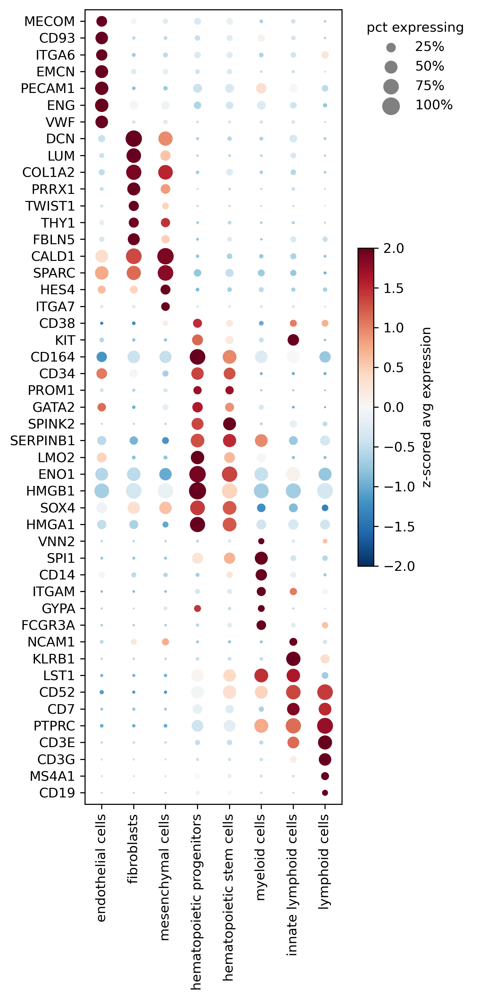

In [8]:
label_map = {
    'endothelial_cells': 'endothelial cells',
    'fibroblasts': 'fibroblasts',
    'mesenchymal_cells': 'mesenchymal cells',
    'hematopoietic_progenitors': 'hematopoietic progenitors',
    'hsc': 'hematopoietic stem cells',
    'innate_lymphoid_cells': 'innate lymphoid cells',
    'lymphoid_cells': 'lymphoid cells',
    'myeloid_cells': 'myeloid cells',
}

cmap = 'RdBu_r'
size_scale = 1.5

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 5, 10.5
fig, ax = plt.subplots()

# genes_sorted.reverse()

for i, gene in enumerate(genes_to_plot):#genes_sorted):
    for j, cluster in enumerate(groups):
        size = float(pct_expr.loc[gene, cluster])*size_scale
        color = float(avg_expr_z.loc[gene, cluster])
        
        ax.scatter(
            x=j, 
            y=i, 
            s=size, 
            c=[color], 
            cmap=cmap,
            vmin=-2, 
            vmax=2, 
        )
        
ax.set_yticks(range(len(genes_to_plot)))
ax.set_yticklabels(genes_to_plot)
# ax.set_yticks(range(len(genes_sorted)))
# ax.set_yticklabels(genes_sorted)
ax.set_xticks(range(len(groups)))
ax.set_xticklabels([label_map.get(g, g) for g in groups], rotation=90)
# ax.set_xticklabels(groups, rotation=90)
# ax.xaxis.set_label_position('top') 
# ax.xaxis.tick_top()
ax.set_xlabel('')

ax.margins(y=0.015, x=0.075)

# legends
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=-2, vmax=2))
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, shrink=0.4, pad=0.05)
cbar.set_label('z-scored avg expression')

sizes = [25, 50, 75, 100]
markers = [plt.scatter([], [], s=s*size_scale, color='gray') for s in sizes]
labels = [f"{s}%" for s in sizes]

ax.legend(markers, labels, title="pct expressing", scatterpoints=1,
          frameon=False, bbox_to_anchor=(1.05, 1), loc='upper left')


plt.tight_layout()
plt.show()

In [6]:
%%time
fpath = "/nfs/turbo/umms-indikar/shared/projects/HSC/pipeline_outputs/hematokytos/sample_1_adata_basename_deg.parquet"

df = pd.read_parquet(fpath)
print(f"Raw data shape: {df.shape=}")
df = df.sort_values(by=['group', 'logfoldchanges'], ascending=[True, False])

df.head()

Raw data shape: df.shape=(417312, 8)
CPU times: user 279 ms, sys: 85.1 ms, total: 364 ms
Wall time: 591 ms


,group,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
7769,endothelial_cells,MIR4454,0.200185,18.774147,0.841336,0.999989,0.000285,0.0
10261,endothelial_cells,RNU6-570P,0.035120,16.763958,0.971984,0.999989,0.000050,0.0
9989,endothelial_cells,ENSG00000286030.2,0.042144,16.398457,0.966384,0.999989,0.000060,0.0
11036,endothelial_cells,PSPC1P2,0.021072,16.307268,0.983188,0.999989,0.000030,0.0
10780,endothelial_cells,MIR5003,0.024584,15.523371,0.980387,0.999989,0.000035,0.0


/tmp/ipykernel_3942882/3984018082.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pdf['label'] = pdf['group'].apply(lambda x: x.replace("_", " "))


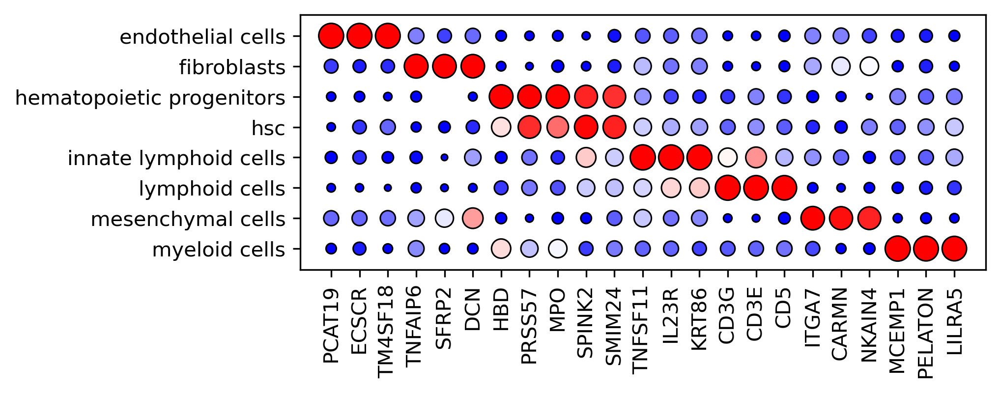

In [53]:
top_n_genes = 3


# filter out genes only expressed in a few cells, robust DEG
pct_nz_group = 0.15
p_thresh = 0.05

gdf = df[df['pct_nz_group'] > pct_nz_group].copy()
gdf = gdf[gdf['pvals_adj'] < p_thresh].copy()

gdf = gdf.groupby('group').head(top_n_genes)

deg_genes = gdf['names'].unique()

# now filter the full frame for these genes
pdf = df[df['names'].isin(deg_genes)]
pdf.head()

pdf['label'] = pdf['group'].apply(lambda x: x.replace("_", " "))
pdf = pdf.sort_values(by=['group', 'logfoldchanges'], ascending=[True, False])

pdf['names'] = pd.Categorical(pdf['names'], categories=deg_genes, ordered=True)


plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 6, 2.25

sns.scatterplot(
    data=pdf,
    x='names',
    y='label',
    hue='logfoldchanges',
    size='logfoldchanges',
    sizes=(0, 150),
    hue_norm=(-5, 5),
    # size='pct_nz_group',
    # size_norm=(0, 0.7),
    ec='k',
    lw=0.75,
    legend=False,
    palette='bwr',
)

plt.margins(y=0.1)
plt.gca().tick_params(axis='x', rotation=90)
plt.ylabel("")
plt.xlabel("")

ax = plt.gca()
y_labels = ax.get_yticklabels()
y_ticks = ax.get_yticks()

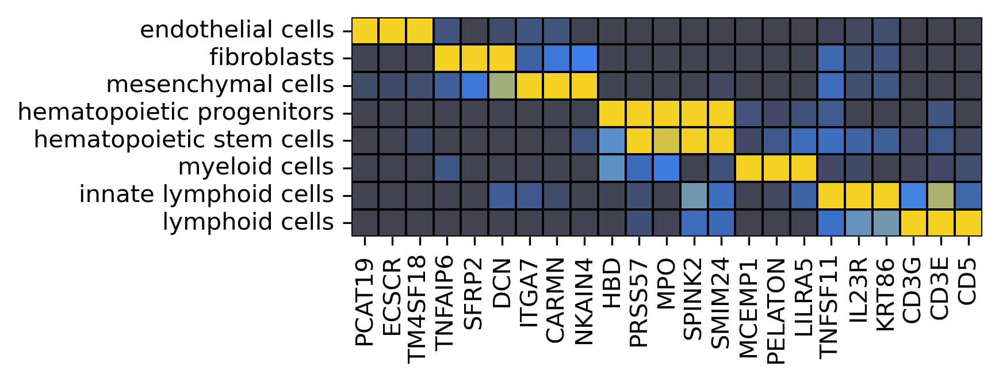

In [9]:
low = '#424251' #'#131317' # dark
mid = '#3B80EB' # blue
high = '#F2D123' # yellow

custom_cmap = LinearSegmentedColormap.from_list(
    "custom_cmap",
    [(0.0, low), (0.15, low), (0.5, mid), (0.85, high), (1.0, high)]
)


top_n_genes = 3
pct_nz_group = 0.15
p_thresh = 0.05

gdf = df[df['pct_nz_group'] > pct_nz_group].copy()
gdf = gdf[gdf['pvals_adj'] < p_thresh].copy()

## Select top N genes per group in the specified group order
deg_genes_ordered = []
for g in groups:
    sub = gdf[gdf['group'] == g]
    sub = sub.sort_values(by='logfoldchanges', ascending=False)
    deg_genes_ordered.extend(sub['names'].head(top_n_genes).tolist())

# Remove duplicates in deg_genes_ordered while preserving order (in case of overlap)
deg_genes_ordered = list(dict.fromkeys(deg_genes_ordered))

# Filter the full dataframe for these DE genes
pdf = df[df['names'].isin(deg_genes_ordered)].copy()

# Set the group and gene columns as categoricals with desired order
pdf['group'] = pd.Categorical(pdf['group'], categories=groups, ordered=True)
pdf['names'] = pd.Categorical(pdf['names'], categories=deg_genes_ordered, ordered=True)

# Sort for better presentation (not strictly required for pivot)
pdf = pdf.sort_values(by=['group', 'logfoldchanges'], ascending=[True, False])

# Pivot so groups become columns and genes become rows
heat_data = pdf.pivot(index='names', columns='group', values='logfoldchanges')
heat_data = heat_data.fillna(0)

# Plotting setup
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 6, 2.25

sns.heatmap(
    heat_data.T,  # Transpose so groups on y, genes on x
    cmap=custom_cmap,
    # cmap='PuOr',
    linewidths=0.5,
    linecolor='k',
    cbar=False,
    annot=False,
    square=True,
    xticklabels=True,
    vmin=-5,
    vmax=5,
)

plt.yticks(
    ticks=np.arange(len(groups)) + 0.5,
    labels=[label_map.get(g, g) for g in groups],
    rotation=0,
    va='center',
)

plt.xlabel("")
plt.ylabel("")
plt.tight_layout()
plt.show()

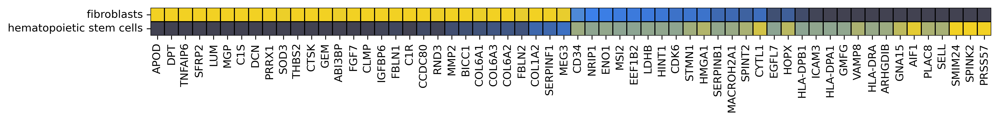

In [23]:
top_n_genes = 30
pct_nz_group = 0.35

# Select top genes
gdf = df[(df['pct_nz_group'] > pct_nz_group) & df['group'].isin(['fibroblasts', 'hsc'])].copy()
gdf = gdf.groupby('group').head(top_n_genes)
deg_genes = gdf['names'].unique()

# Filter full frame
pdf = df[df['names'].isin(deg_genes) & df['group'].isin(['fibroblasts', 'hsc'])].copy()
pdf = pdf.sort_values(by=['group', 'logfoldchanges'], ascending=[True, False])

# Pivot for heatmap (genes as rows, groups as columns)
heat_data = pdf.pivot(index='names', columns='group', values='logfoldchanges')
heat_data = heat_data.fillna(0)  # or np.nan if you prefer masking

heat_data['sort_key'] = heat_data['fibroblasts'] - heat_data['hsc']
heat_data = heat_data.sort_values(by='sort_key', ascending=False)
heat_data = heat_data.drop(columns='sort_key')

# Plot heatmap
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 13, 5

sns.heatmap(
    heat_data.T,
    cmap=custom_cmap,
    linewidths=0.5,
    linecolor='k',
    cbar=False,
    # cbar_kws={"label": "logFC"},
    annot=False,
    square=True,
    # annot_kws={'fontsize' : 4},
    xticklabels=True,
    yticklabels=['fibroblasts', 'hematopoietic stem cells'],
    vmin=-5,
    vmax=5,
)

plt.xlabel("")
plt.ylabel("")
plt.tight_layout()
plt.show()

In [34]:
%%time 
# === Load and filter GTF ===
gpath = "/scratch/indikar_root/indikar1/shared_data/HYB/resources/refdata-gex-GRCh38-2024-A_genes.csv.gz"

gtf = pd.read_csv(gpath)

gtf = gtf[(gtf['Feature'] == 'gene') & (gtf['gene_type'] == 'protein_coding')]

gtf = gtf[['gene_id', 'gene_name', 'gene_type']]

gtf.head()

CPU times: user 7.81 s, sys: 1.03 s, total: 8.84 s
Wall time: 8.9 s


,gene_id,gene_name,gene_type
0,ENSG00000278704,ENSG00000278704,protein_coding
8,ENSG00000277400,ENSG00000277400,protein_coding
20,ENSG00000274847,MAFIP,protein_coding
34,ENSG00000276256,ENSG00000276256,protein_coding
44,ENSG00000277630,ENSG00000277630,protein_coding


In [35]:
gtf = gtf[~gtf['gene_name'].str.startswith('ENSG')]

print(gtf.shape)
print(gtf['gene_name'].nunique())
print(gtf['gene_id'].nunique())

(19294, 3)
19291
19294


In [60]:
# tmp = df[df['group'] == 'mesenchymal_cells']
tmp = df[df['group'] == 'myeloid_cells']

tmp = tmp[~tmp['names'].str.startswith(('ENSG', 'MT-', 'RP'))]
tmp = pd.merge(tmp, gtf, how='left', left_on='names', right_on='gene_name')

tmp = tmp.dropna(subset='gene_name')
print(tmp.shape)
tmp.head()

(18924, 11)


,group,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,gene_id,gene_name,gene_type
6,myeloid_cells,XAGE1A,0.028097,15.949018,0.977585,0.999997,0.000040,0.0,ENSG00000204379,XAGE1A,protein_coding
18,myeloid_cells,TSPY9,0.010536,14.580681,0.991593,0.999997,0.000015,0.0,ENSG00000238074,TSPY9,protein_coding
32,myeloid_cells,USP17L19,0.010536,14.006997,0.991593,0.999997,0.000015,0.0,ENSG00000248920,USP17L19,protein_coding
36,myeloid_cells,USP17L29,0.010536,13.924485,0.991593,0.999997,0.000015,0.0,ENSG00000231637,USP17L29,protein_coding
54,myeloid_cells,OR8G3P,0.010536,13.037430,0.991593,0.999997,0.000015,0.0,ENSG00000255425,OR8G3P,protein_coding


In [61]:
tmp['names'].head(30)

6         XAGE1A
18         TSPY9
32      USP17L19
36      USP17L29
54        OR8G3P
114    GOLGA6L25
115        TAAR8
144       SCYGR7
151      TAF11L2
168       OR4C15
193    KRTAP10-8
219         AGRP
231       MCEMP1
241      SCGB1C1
246        OR1P1
254      DNASE2B
263        OR4B1
276       LY6G6F
279        FOLR3
282      SIGLEC8
289         PRY2
292          MOS
296       LILRA5
297       MS4A6E
299        TREM1
303         OLR1
304         FCN1
308      S100A12
310         FPR2
321       CD300E
Name: names, dtype: object

In [62]:
tmp.sort_values(by='scores', ascending=False).head(10)

,group,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,gene_id,gene_name,gene_type
437,myeloid_cells,TYROBP,444.594604,5.467069,0.0,0.0,0.679481,0.091474,ENSG00000011600,TYROBP,protein_coding
506,myeloid_cells,FCER1G,426.750061,5.173647,0.0,0.0,0.654449,0.085367,ENSG00000158869,FCER1G,protein_coding
399,myeloid_cells,LYZ,389.116974,5.633084,0.0,0.0,0.604914,0.088012,ENSG00000090382,LYZ,protein_coding
920,myeloid_cells,CTSS,384.699188,4.076343,0.0,0.0,0.637017,0.185136,ENSG00000163131,CTSS,protein_coding
866,myeloid_cells,LST1,363.865204,4.179408,0.0,0.0,0.584371,0.096931,ENSG00000204482,LST1,protein_coding
2594,myeloid_cells,FTL,363.816437,2.313227,0.0,0.0,0.887563,0.808262,ENSG00000087086,FTL,protein_coding
418,myeloid_cells,S100A9,355.433960,5.547428,0.0,0.0,0.555918,0.081059,ENSG00000163220,S100A9,protein_coding
1373,myeloid_cells,AIF1,347.921082,3.366492,0.0,0.0,0.612984,0.154018,ENSG00000204472,AIF1,protein_coding
1998,myeloid_cells,S100A4,336.325195,2.750922,0.0,0.0,0.717925,0.419785,ENSG00000196154,S100A4,protein_coding
2254,myeloid_cells,SRGN,335.026337,2.552811,0.0,0.0,0.724211,0.356951,ENSG00000122862,SRGN,protein_coding


# t-SNEs (supp)

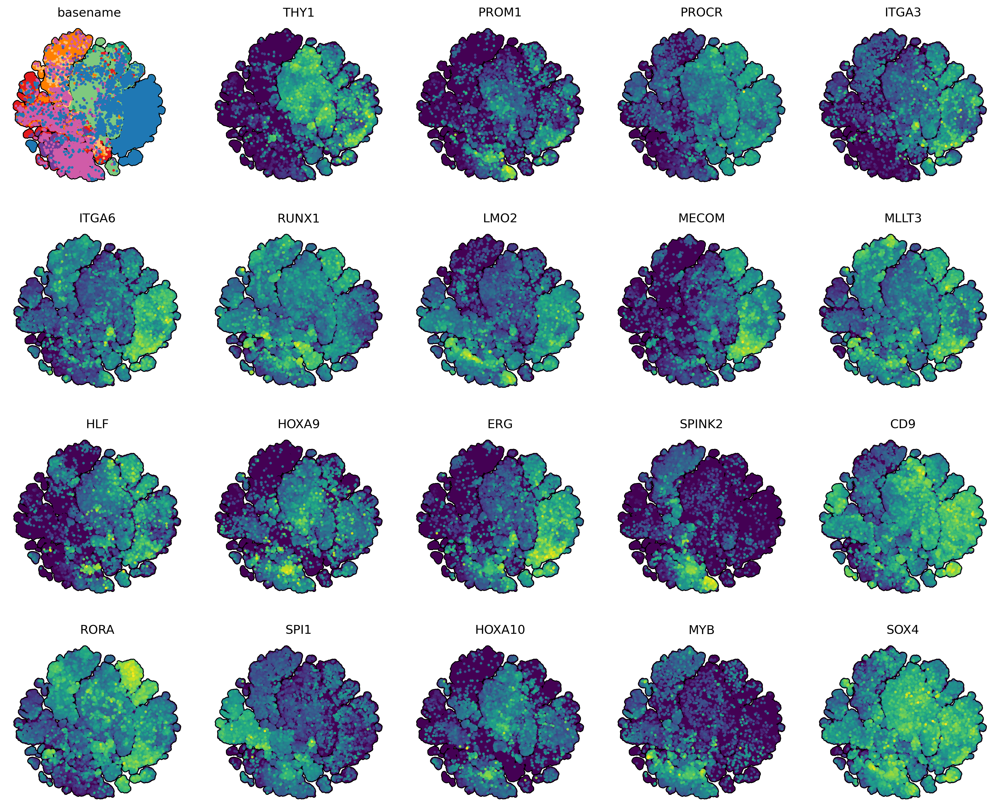

In [21]:
genes_to_plot = [
    'THY1', 'PROM1', 'PROCR', 'ITGA3', 'ITGA6', 
    'RUNX1', 'LMO2', 'MECOM', 'MLLT3', 'HLF', 'HOXA9',
    'ERG', 'SPINK2', 'CD9', 'RORA', 'SPI1',
    'HOXA10', 'MYB', 'SOX4',
]

genes_to_plot = [g for g in genes_to_plot if g in adata.var_names]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 3, 3.15

sc.pl.tsne(
    adata,
    color=['basename'] + genes_to_plot,
    # sort_order=True,
    size=25,
    ncols=5,
    alpha=1,
    use_raw=False,
    add_outline=True,
    legend_loc='none',
    outline_color=('k', 'k'),
    frameon=False,
    colorbar_loc=None,
    wspace=0.12,
    # hspace=0.1,
    # layer='log_norm',
)

In [ ]:
genes_to_plot = [
    'THY1', 'PROM1', 'PROCR', 'ITGA3', 'ITGA6', 
    'RUNX1', 'LMO2', 'MECOM', 'MLLT3', 'HLF', 'HOXA9',
    'ERG', 'SPINK2', 'CD9', 'RORA', 'SPI1',
    'HOXA10', 'MYB', 'SOX4',
]

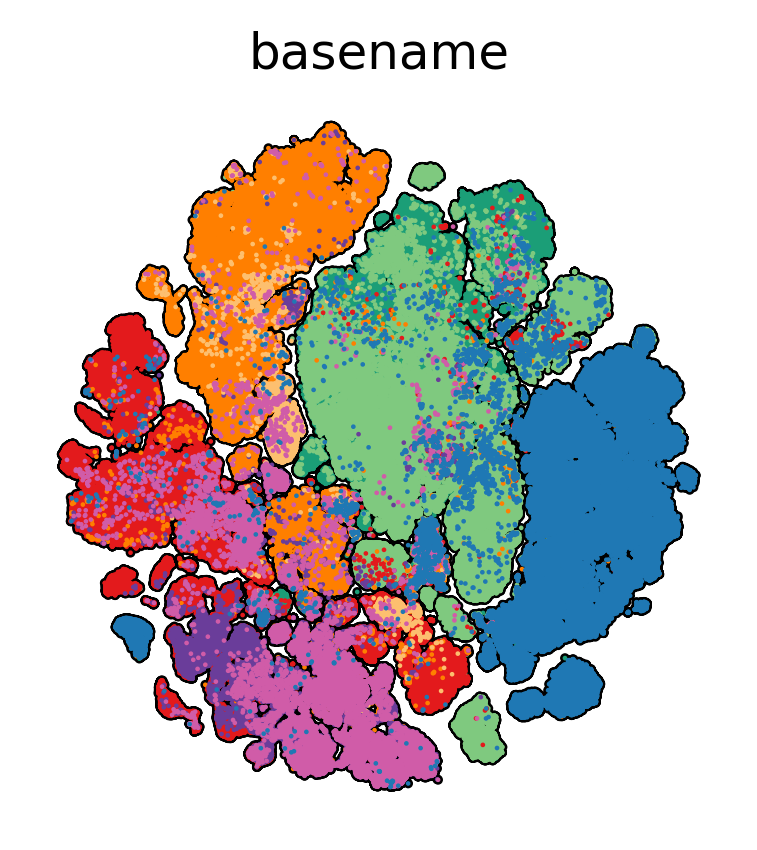

In [20]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 3, 3.15

sc.pl.tsne(
    adata,
    color='basename',
    # sort_order=True,
    size=5,
    ncols=1,
    alpha=1,
    use_raw=False,
    add_outline=True,
    outline_color=('k', 'k'),
    outline_width=(0.5,0.05),
    frameon=False,
    legend_loc='none',
)